### This notebook plays around with node degrees and looks at the impact of systematically deleting SC ...

#### In this notebook (based on the convo with "Dave"), I try to isolate the different FC NTwx, but strcuturally. 
##### I will then run whobpyt on these structurally isolated ntwx to see how it affects FC, potentially shedding some light on how FC ntwx emerge. 

##### 'structurally isolate' means virtual lesions that make the regions of the a given network (eg: DMN) only have connections to itself.   
##### Essentially, you set the conncetions of the DMN regions/parcels with other ntwx to 0 in the SC mtx.  

##### All of the above will be first attempted for a single subject.  
##### This NB uses a resolution of 200 Schaefer parcellations.  

In [1]:
# Importage
import warnings
warnings.filterwarnings('ignore')

# os stuff
import os
import sys

import nibabel as nib
from nilearn.plotting import plot_surf, plot_surf_stat_map, plot_roi, plot_anat, plot_surf_roi
from nilearn.image import index_img

import seaborn as sns

# whobpyt stuff
import whobpyt
from whobpyt.data.dataload import dataloader
# from whobpyt.models.jansen_rit import RNNJANSEN
from whobpyt.models.wong_wang import RNNRWW
from whobpyt.datatypes.modelparameters import ParamsModel
from whobpyt.optimization.modelfitting import Model_fitting

# array and pd stuff
import numpy as np
import pandas as pd

# viz stuff
import matplotlib.pyplot as plt

In [2]:
from collections import Counter

In [3]:
import pickle

In [4]:
parcs = np.arange(0,200,1)

mask = np.tril_indices(len(parcs), -1)

# Labels
_label_file =  '/external/rprshnas01/kcni/hharita/Code/whobpyt/scratch/Schaefer200_7_Ntwx_labels.txt'

f = open(_label_file, "r")
q = f.read()
q = q.rsplit('\n')
# del q[-32:]
labels = q.copy()
labels = np.array(labels)
labels = labels[parcs]


In [5]:
Davide_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/Neg_Corrs_Jam_Session_June_2022/Davide_HCP_Data_Matrix'

ShreyVB_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/Neg_Corrs_Jam_Session_June_2022'

Wts_Path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/Improved_WWD_HCP_model_runs/Sub_Specific_SC_Wts_2'

pconn_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/Shrey_SS_parcellated_Func_Conns_II/'

# _sub_list = [200614, 199958, 177746, 164131, 141826, 130619, 127933, 116726, 100307, 100206]
# sub_list = list(reversed(_sub_list))

parcs = np.arange(0,200,1)

In [6]:
# %%
# define options for wong-wang model
node_size = 200
mask = np.tril_indices(node_size, -1)
num_epoches = 20 #50
batch_size = 20
step_size = 0.05
input_size = 2
tr = 2.0
repeat_size = 5

In [7]:
sub_list_1 = [100610, 103111, 118528, 139637, 144428, 158136, 182739, 102513, 102816, 107321, 107422, 108525, 112112, 121618, 129331]
sub_list_2 = [129634, 132118, 133625, 133827, 134829, 137936, 153227, 154936, 156334, 173435]
sub_list = np.concatenate((sub_list_1, sub_list_2))
sub_list.sort()

In [8]:
def load_wts(sub_id):
    
    _gg = np.loadtxt(Wts_Path + "/{0}_SC_wts.txt".format(sub_id))

    # Structural Connectivity
    HCP_SC1 = _gg[parcs][:,parcs] 
    HCP_SC1 = HCP_SC1 + HCP_SC1.T # --> Symmetric
    pre_laplachian_HCP_SC = HCP_SC1.copy()

    # Laplachian!

    HCP_SC = -np.diag((pre_laplachian_HCP_SC/np.linalg.norm(pre_laplachian_HCP_SC)).sum(0)) + pre_laplachian_HCP_SC/np.linalg.norm(pre_laplachian_HCP_SC)
    
    return pre_laplachian_HCP_SC, HCP_SC

In [9]:
%%time
all_subs_pre_lap_SC = []
all_subs_HCP_SC = []

for i in range(len(sub_list)):
    pre_lap_SC, ss_SC = load_wts(sub_list[i])
    all_subs_pre_lap_SC.append(pre_lap_SC)
    all_subs_HCP_SC.append(ss_SC)

CPU times: user 923 ms, sys: 34 ms, total: 957 ms
Wall time: 1.79 s


In [10]:
pconn_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/Shrey_SS_parcellated_Func_Conns_II/'

In [11]:
def load_FC(sub_id):
    
    pconn1LR = pconn_path + '{0}_rfMRI_REST1_RL_Schaefer200_cifti_parcellated.ptseries.nii'.format(sub_id)
#     pconn1RL = pconn_path + '{0}_rfMRI_REST1_RL_Schaefer200_cifti_correlated.pconn.nii'.format(sub_id)
#     pconn2LR = pconn_path + '{0}_rfMRI_REST2_LR_Schaefer200_cifti_correlated.pconn.nii'.format(sub_id)
#     pconn2RL = pconn_path + '{0}_rfMRI_REST2_RL_Schaefer200_cifti_correlated.pconn.nii'.format(sub_id)
    
    _pconn_img1LR = nib.load(pconn1LR)
    _pconn_dat1LR = _pconn_img1LR.get_data()
    _pconn_dat1LR = _pconn_dat1LR/1

#     _pconn_img1RL = nib.load(pconn1RL)
#     _pconn_dat1RL = _pconn_img1RL.get_data()
#     _pconn_dat1RL = _pconn_dat1RL/1

#     _pconn_img2LR = nib.load(pconn2LR)
#     _pconn_dat2LR = _pconn_img2LR.get_data()
#     _pconn_dat2LR = _pconn_dat2LR/1

#     _pconn_img2RL = nib.load(pconn2RL)
#     _pconn_dat2RL = _pconn_img2RL.get_data()
#     _pconn_dat2RL = _pconn_dat2RL/1
    
#     _test_pconn = (_pconn_dat1LR + _pconn_dat1LR + _pconn_dat2LR + _pconn_dat2RL)/4
    
    return _pconn_dat1LR

In [12]:
%%time
all_subs_pconn1LR = []
# all_subs_pconn1RL = []
# all_subs_pconn2LR = []
# all_subs_pconn2RL = []
# all_subs_FC = []


for i in range(len(sub_list)):

    _1LR = load_FC(sub_list[i])
    all_subs_pconn1LR.append(_1LR)
#     all_subs_pconn1RL.append(_1RL)
#     all_subs_pconn2LR.append(_2LR)
#     all_subs_pconn2RL.append(_2RL)
#     all_subs_FC.append(avg_ss_pconn)

CPU times: user 7.91 s, sys: 178 ms, total: 8.09 s
Wall time: 9.53 s


In [13]:
# for i in range(10):
#     _var =np.corrcoef(all_subs_pconn1LR[i].T)
#     fig,ax = plt.subplots()
#     sns.heatmap(_var,cmap='RdBu_r',center=0,vmax=0.5)

In [52]:
_var =np.corrcoef(all_subs_pconn1LR[0].T)

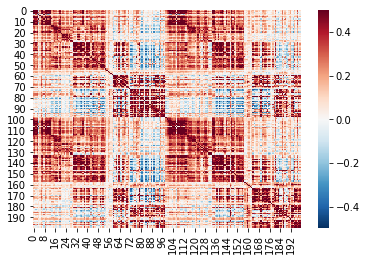

In [53]:
sns.heatmap(_var,cmap='RdBu_r',center=0,vmax=0.5)

In [14]:
data_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/WhoBPyT/HCP_200_parcs'

In [15]:
def open_pickles(sub_id):
    filename = data_path + '/Subj_{0}_fittingresults_stim_exp.pkl'.format(sub_id)
    with open(filename, 'rb') as f:
        g = pickle.load(f)
    
    outfilename = data_path + '/Subj_{0}_simEEG_stim_exp.pkl'.format(sub_id)
    with open(outfilename, 'rb') as f1:
        g1 = pickle.load(f1)
    
    return g, g1

In [16]:
# %%time
# all_subs_fittingresults = []
# all_subs_simEEG = []
# for i in range(len(sub_list)):
#     ss_fittingresult, ss_simEEG = open_pickles(sub_list[i])
#     all_subs_fittingresults.append(ss_fittingresult)
#     all_subs_simEEG.append(ss_simEEG)

In [17]:
sub_id = sub_list[0]

In [18]:
%%time
filename = data_path + '/Subj_{0}_fittingresults_stim_exp.pkl'.format(sub_id)
with open(filename, 'rb') as f:
    g = pickle.load(f)

CPU times: user 127 ms, sys: 641 ms, total: 768 ms
Wall time: 4.43 s


In [19]:
%%time
filename = data_path + '/Subj_{0}_fittingresults_stim_exp.pkl'.format(sub_id)
with open(filename, 'rb') as f:
    g2 = pickle.load(f)

CPU times: user 106 ms, sys: 476 ms, total: 583 ms
Wall time: 588 ms


### calculate the node degree of the fitted SC matrix

In [20]:
# og_data_all_subs = g.copy()
# og_data_all_subs2 = g.copy()
# og_data_all_subs3 = g.copy()
# og_data_all_subs4 = g.copy()
# og_data_all_subs5 = g.copy()
# og_data_all_subs6 = g.copy()
# og_data_all_subs7 = g.copy()
# og_data_all_subs8 = g.copy()

In [21]:
# og_data_all_subs9 = all_subs_fittingresults.copy()

In [22]:
# model.gains_con is the modification/change to the original SC. 

# Here is a simpler way to understand this ...

# original_sc * model.gains_con = fitted_sc

In [23]:
# a single subject's data ...

# ss_og_data = og_data_all_subs[0]

In [24]:
# fig, ax = plt.subplots(figsize=(13,9))
# sns.heatmap(ss_og_data.model.sc)

In [25]:
# 'structurally isolate' means virtual lesions that make the regions of the a given network ...
# ... (eg: DMN) only have connections to itself.   

# Essentially, you set the connections of the DMN regions/parcels with other ntwx to 0 in the SC mtx.

In [26]:
original_sc = g.model.sc.copy()

###### left hemisphere

In [27]:
lh_labels = labels[0:100]
rh_labels = labels[100:200]

In [28]:
ntwx_labels = ['Vis', 'SomMot', 'DAN', 'VAN', 'Limbic', 'FPN', 'DMN', 'TempPar']

lh_input_array = lh_labels.copy()

# Initialize the output lists
lh_vis_list = []
lh_som_mot_list = []
lh_dors_attn_list = []
lh_sal_vent_attn_list = []
lh_limbic_list = []
lh_cont_list = []
lh_default_list = []
lh_temp_par_list = []


# Iterate over each string in the input array
for string in lh_input_array:
    if 'Vis' in string:
        lh_vis_list.append(string)
    elif 'SomMot' in string:
        lh_som_mot_list.append(string)
    elif 'DorsAttn' in string:
        lh_dors_attn_list.append(string)
    elif 'SalVentAttn' in string:
        lh_sal_vent_attn_list.append(string)
    elif 'Limbic' in string:
        lh_limbic_list.append(string)
    elif 'Cont' in string:
        lh_cont_list.append(string)
    elif 'Default' in string:
        lh_default_list.append(string)
    elif 'TempPar' in string:
        lh_temp_par_list.append(string)

In [29]:
print(len(lh_vis_list))
print(len(lh_som_mot_list))
print(len(lh_dors_attn_list))
print(len(lh_sal_vent_attn_list))
print(len(lh_limbic_list))
print(len(lh_cont_list))
print(len(lh_default_list))
print(len(lh_temp_par_list))

14
16
13
11
6
13
27
0


In [30]:
lh_list = [0,14,16,13,11,6,13,27]
ll = np.cumsum(lh_list)
ll = ll.tolist()
ll_actual = ll.copy()
# print(np.cumsum(lh_list))  

In [31]:
ll_actual

[0, 14, 30, 43, 54, 60, 73, 100]

###### right hemipshere

In [32]:
rh_input_array = rh_labels.copy()

# Initialize the output lists
rh_vis_list = []
rh_som_mot_list = []
rh_dors_attn_list = []
rh_sal_vent_attn_list = []
rh_limbic_list = []
rh_cont_list = []
rh_default_list = []
rh_temp_par_list = []


# Iterate over each string in the input array
for string in rh_input_array:
    if 'Vis' in string:
        rh_vis_list.append(string)
    elif 'SomMot' in string:
        rh_som_mot_list.append(string)
    elif 'DorsAttn' in string:
        rh_dors_attn_list.append(string)
    elif 'SalVentAttn' in string:
        rh_sal_vent_attn_list.append(string)
    elif 'Limbic' in string:
        rh_limbic_list.append(string)
    elif 'Cont' in string:
        rh_cont_list.append(string)
    elif 'Default' in string:
        rh_default_list.append(string)
    elif 'TempPar' in string:
        rh_temp_par_list.append(string)

In [33]:
print(len(rh_vis_list))
print(len(rh_som_mot_list))
print(len(rh_dors_attn_list))
print(len(rh_sal_vent_attn_list))
print(len(rh_limbic_list))
print(len(rh_cont_list))
print(len(rh_default_list))
print(len(rh_temp_par_list))

15
19
13
11
6
17
19
0


In [34]:
rh_list = [0,15,19,13,11,6,17,19]
rr = np.cumsum(rh_list)
rr = rr.tolist()
rr
# print(np.cumsum(rh_list))  

[0, 15, 34, 47, 58, 64, 81, 100]

In [35]:
rr_actual = [x + 100 for x in rr]

rr_actual

[100, 115, 134, 147, 158, 164, 181, 200]

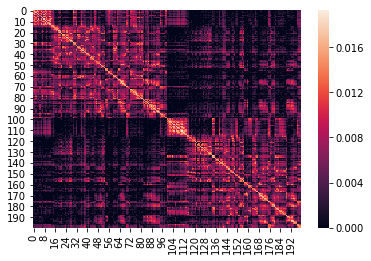

In [36]:
sns.heatmap(original_sc)

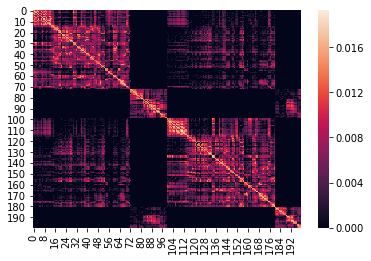

In [37]:
# Assuming the original matrix is named 'original_matrix'
original_matrix = original_sc.copy()
# print(original_matrix)

# Create a new matrix with the same shape as the original matrix
modified_matrix = original_sc.copy()

modified_matrix[73:100,0:73] = 0
modified_matrix[73:100,100:181] = 0
modified_matrix[181:200,0:73] = 0
modified_matrix[181:200,100:181] = 0

modified_matrix[0:73,73:100] = 0
modified_matrix[100:181,73:100] = 0
modified_matrix[0:73,181:200] = 0
modified_matrix[100:181,181:200] = 0

sns.heatmap(modified_matrix)

In [38]:
# lh_start = 73 --> a
# lh_end = 100 --> b
# rh_start = 181 --> c
# rh_end = 200 --> d

In [39]:
# basically, use the label file row, cols and structurally isolate the func ntwx ...


# use the start and end values based on lh_start,lh_end,rh_start,rh_end
# so for the DMN ... this is 

def structurally_isolate_func_ntwx(a,b,c,d):
    
    modified_matrix = original_sc.copy()

    modified_matrix[a:b,0:a] = 0
    modified_matrix[a:b,b:c] = 0
    modified_matrix[c:d,0:a] = 0
    modified_matrix[c:d,b:c] = 0

    modified_matrix[0:a,a:b] = 0
    modified_matrix[b:c,a:b] = 0
    modified_matrix[0:a,c:d] = 0
    modified_matrix[b:c,c:d] = 0
    
    modified_matrix = modified_matrix/np.linalg.norm(modified_matrix)
    
    return modified_matrix

In [40]:
print(ll_actual)
print(rr_actual)



[0, 14, 30, 43, 54, 60, 73, 100]
[100, 115, 134, 147, 158, 164, 181, 200]


In [41]:
# vis isolated sc ... only connections with vis is kept, rest are 0.

vis_isolated_sc = structurally_isolate_func_ntwx(0,14,100,115)
sommot_isolated_sc = structurally_isolate_func_ntwx(14,30,115,134)
dorsattn_isolated_sc = structurally_isolate_func_ntwx(30,43,134,147)
ventattn_isolated_sc = structurally_isolate_func_ntwx(43,54,147,158)
limbic_isolated_sc = structurally_isolate_func_ntwx(54,60,158,164)
fpn_isolated_sc = structurally_isolate_func_ntwx(60,73,164,181)
dmn_isolated_sc = structurally_isolate_func_ntwx(73,100,181,200)


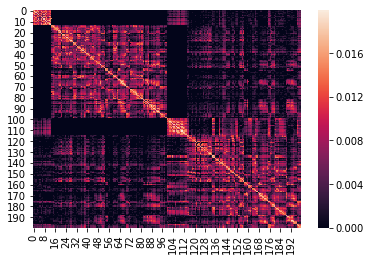

In [42]:
sns.heatmap(vis_isolated_sc)

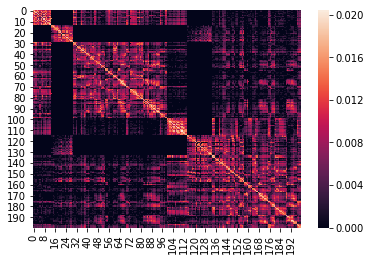

In [43]:
sns.heatmap(sommot_isolated_sc)

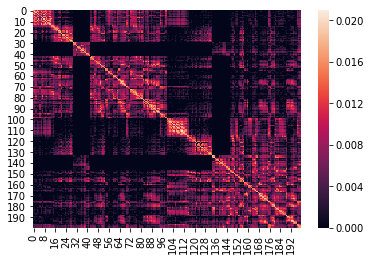

In [44]:
sns.heatmap(dorsattn_isolated_sc)

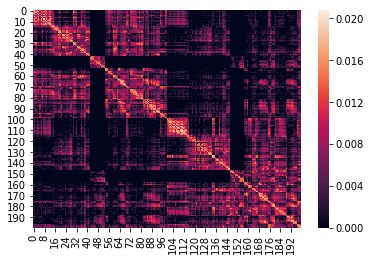

In [45]:
sns.heatmap(ventattn_isolated_sc)

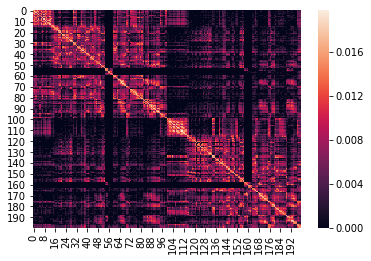

In [46]:
sns.heatmap(limbic_isolated_sc)

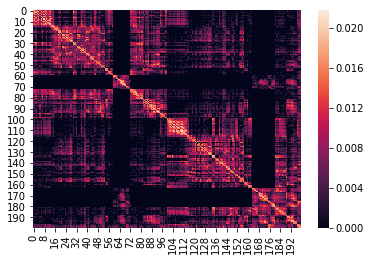

In [47]:
sns.heatmap(fpn_isolated_sc)

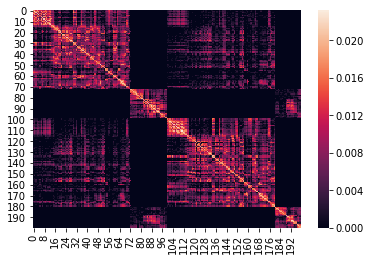

In [48]:
sns.heatmap(dmn_isolated_sc)

In [49]:
# _j = og_data_all_subs[0].output_sim.bold_test.copy()

In [50]:
ss_og_data = g

# vis_iso_data = g
# sommot_iso_data = g
# dorsattn_iso_data = og_data_all_subs4[6]
# ventattn_iso_data = og_data_all_subs5[6]
# limbic_iso_data = og_data_all_subs6[6]
# fpn_iso_data = og_data_all_subs7[6]
dmn_iso_data = g2 

#### empirical

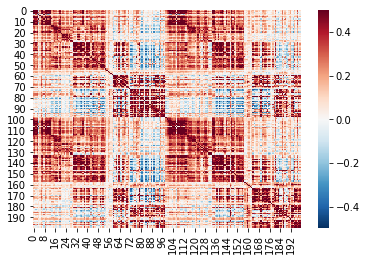

In [54]:
sns.heatmap(_var,cmap='RdBu_r',center=0,vmax=0.5)

#### simulated

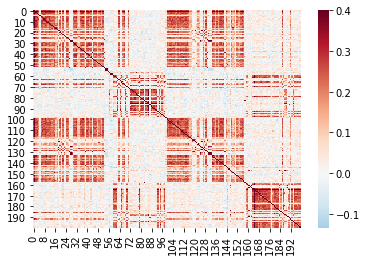

In [64]:
sns.heatmap(np.corrcoef(g.output_sim.bold_test),cmap='RdBu_r',center=0,vmax=0.4)

In [56]:
np.corrcoef(np.corrcoef(g.output_sim.bold_test)[mask],_var[mask])[0][1]

0.5794178052600557

#### dmn isolated sc

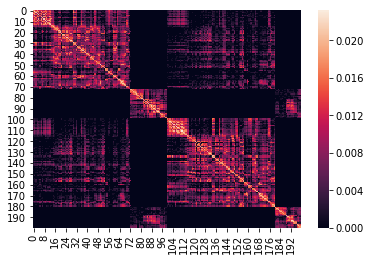

In [57]:
sns.heatmap(dmn_isolated_sc)

#### dmn isolated

In [58]:
dmn_iso_data.model.sc = dmn_isolated_sc.copy()

In [59]:
%%time
dmn_iso_data.test(20)

0.5399146324893442 cos_sim:  0.9940778375525866
CPU times: user 5min 6s, sys: 8.17 s, total: 5min 14s
Wall time: 7min 23s


In [60]:
# np.corrcoef(dmn_iso_data.output_sim.bold_test)

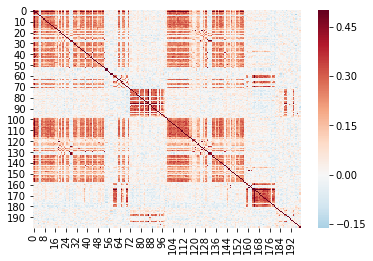

In [61]:
sns.heatmap(np.corrcoef(dmn_iso_data.output_sim.bold_test),cmap='RdBu_r',center=0,vmax=0.5)

In [63]:
org_whobpyt_fc = np.corrcoef(g.output_sim.bold_test)

In [67]:
lesion_whobpyt_fc = np.corrcoef(dmn_iso_data.output_sim.bold_test)

In [68]:
dmn_only_whobpyt_fc = org_whobpyt_fc[73:100,73:100]

dmn_only_lesion_whobpyt_fc = lesion_whobpyt_fc[73:100,73:100]

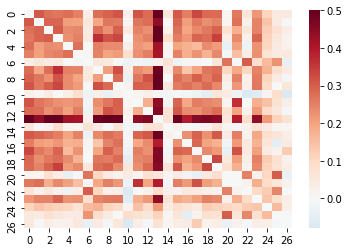

In [69]:
sns.heatmap(dmn_only_whobpyt_fc-np.diag(np.diag(dmn_only_whobpyt_fc)), cmap='RdBu_r',center=0,vmax=0.5)

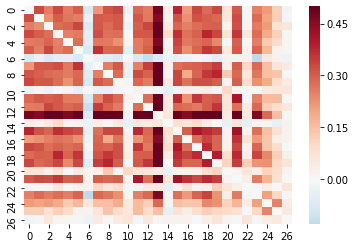

In [70]:
sns.heatmap(dmn_only_lesion_whobpyt_fc-np.diag(np.diag(dmn_only_lesion_whobpyt_fc)), cmap='RdBu_r',center=0,vmax=0.5)

In [71]:
rh_dmn_only_whobpyt_fc = org_whobpyt_fc[181:200,181:200]

rh_dmn_only_lesion_whobpyt_fc = lesion_whobpyt_fc[181:200,181:200]

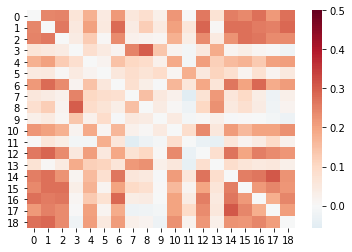

In [72]:
sns.heatmap(rh_dmn_only_whobpyt_fc-np.diag(np.diag(rh_dmn_only_whobpyt_fc)), cmap='RdBu_r',center=0,vmax=0.5)

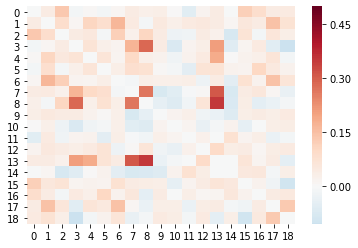

In [73]:
sns.heatmap(rh_dmn_only_lesion_whobpyt_fc-np.diag(np.diag(rh_dmn_only_lesion_whobpyt_fc)), cmap='RdBu_r',center=0,vmax=0.5)

In [82]:
sns.set_style("darkgrid")

In [83]:
u,d,v = np.linalg.svd(rh_dmn_only_whobpyt_fc)

In [84]:
u1,d1,v1 = np.linalg.svd(rh_dmn_only_lesion_whobpyt_fc)

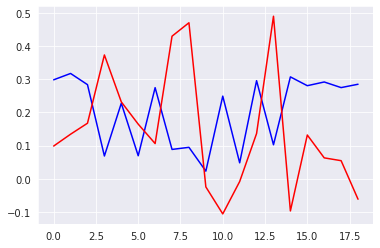

In [85]:
plt.plot(-u[:,0],c='b')
plt.plot(-u1[:,0],c='r')
plt.show()

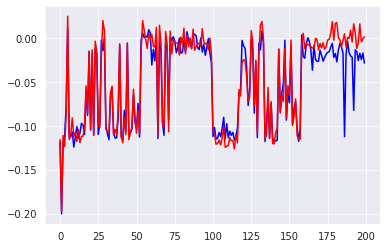

In [86]:
p,q,r = np.linalg.svd(org_whobpyt_fc)

p1,q1,r1 = np.linalg.svd(lesion_whobpyt_fc)

plt.plot(p[:,0],c='b')
plt.plot(p1[:,0],c='r')
plt.show()

In [ ]:
# take the average eigenvector across subjects

### Surface plots

In [80]:
%%time
# Load on surfaces ...

data_direc = '/nethome/kcni/hharita/Data/HCP_WB_Tutorial_TEST/HCP_WB_Tutorial_1.0'

# Left Hemisphere MID-THICKNESS Surface file
mtleft_file = data_direc + '/Q1-Q6_R440.L.midthickness.32k_fs_LR.surf.gii'

# Left Hemisphere INFLATED Surface file
infleft_file = data_direc + '/Q1-Q6_R440.L.inflated.32k_fs_LR.surf.gii'

# Left Hemisphere VERY INFLATED Surface file 
vinfleft_file = data_direc + '/Q1-Q6_R440.L.very_inflated.32k_fs_LR.surf.gii'

# Left Hemisphere PIAL Surface file
pialleft_file = data_direc + '/Q1-Q6_R440.L.pial.32k_fs_LR.surf.gii'

# right Hemisphere MID-THICKNESS Surface file
mtright_file = data_direc + '/Q1-Q6_R440.R.midthickness.32k_fs_LR.surf.gii'

# right Hemisphere INFLATED Surface file
infright_file = data_direc + '/Q1-Q6_R440.R.inflated.32k_fs_LR.surf.gii'

# right Hemisphere VERY INFLATED Surface file 
vinfright_file = data_direc + '/Q1-Q6_R440.R.very_inflated.32k_fs_LR.surf.gii'

# right Hemisphere PIAL Surface file
pialright_file = data_direc + '/Q1-Q6_R440.R.pial.32k_fs_LR.surf.gii'

# for the cifti-2 converted label file
anotherdir = '/external/rprshnas01/kcni/hharita/Data/HCP_WB_Tutorial_TEST/HCP_WB_Tutorial_1.0'
label_file = anotherdir + '/parcellations_VGD11b.32k_fs_LR_c2.dlabel.nii'

# %%time
# read in the loaded surfaces ...

# Mid-thickness surface
img_mt = nib.load(mtleft_file) 
mt_vtx = img_mt.darrays[0].data
mt_tri = img_mt.darrays[1].data

# Pial surface
img_pial = nib.load(pialleft_file)
pial_vtx = img_pial.darrays[0].data
pial_tri = img_pial.darrays[1].data

# Inflated surface
img_inf = nib.load(infleft_file)
inf_vtx = img_inf.darrays[0].data
inf_tri = img_inf.darrays[1].data

# Inflated surface
img_vinf = nib.load(vinfleft_file)
vinf_vtx = img_vinf.darrays[0].data
vinf_tri = img_vinf.darrays[1].data

# mid-thickness
df_mt_vtx = pd.DataFrame(mt_vtx, columns=['x','y','z'])

# pial
df_pial_vtx = pd.DataFrame(pial_vtx, columns=['x','y','z'])

# inflated 
df_inf_vtx = pd.DataFrame(inf_vtx, columns=['x','y','z'])

# very inflated
df_vinf_vtx = pd.DataFrame(vinf_vtx, columns=['x','y','z'])

# %%time
# read in the loaded surfaces ...

# Mid-thickness surface
r_img_mt = nib.load(mtright_file) 
r_mt_vtx = r_img_mt.darrays[0].data
r_mt_tri = r_img_mt.darrays[1].data

# Pial surface
r_img_pial = nib.load(pialright_file)
r_pial_vtx = r_img_pial.darrays[0].data
r_pial_tri = r_img_pial.darrays[1].data

# Inflated surface
r_img_inf = nib.load(infright_file)
r_inf_vtx = r_img_inf.darrays[0].data
r_inf_tri = r_img_inf.darrays[1].data

# Inflated surface
r_img_vinf = nib.load(vinfright_file)
r_vinf_vtx = r_img_vinf.darrays[0].data
r_vinf_tri = r_img_vinf.darrays[1].data

# mid-thickness
r_df_mt_vtx = pd.DataFrame(r_mt_vtx, columns=['x','y','z'])

# pial
r_df_pial_vtx = pd.DataFrame(r_pial_vtx, columns=['x','y','z'])

# inflated 
r_df_inf_vtx = pd.DataFrame(r_inf_vtx, columns=['x','y','z'])

# very inflated
r_df_vinf_vtx = pd.DataFrame(r_vinf_vtx, columns=['x','y','z'])

# %%time

# Pial surface --> RIGHT hemisphere ...
img_pial_rh = nib.load(pialright_file)
pial_vtx_rh = img_pial_rh.darrays[0].data
pial_tri_rh = img_pial_rh.darrays[1].data

xr,yr,zr = pial_vtx_rh.T
x,y,z = pial_vtx.T

# %%time
# Load the dconn file like previous NBs
dconn_file = '/nethome/kcni/hharita/Data/HCP_1200/HCP_S1200_1003_rfMRI_MSMAll_groupPCA_d4500ROW_zcorr.dconn.nii'
dconn_img = nib.load(dconn_file)
dconn_dat = dconn_img.get_data()
dconn_hdr = dconn_img.header
dconn_ax0 = dconn_hdr.get_axis(0)
dconn_ax1 = dconn_hdr.get_axis(1)

cbig_dir = '/external/rprshnas01/netdata_kcni/jglab/Code/libraries_of_others/github/CBIG'

# Load in 1000 parcellation variant of Schaefer parcellations label file ...
sch200lab_file = cbig_dir + '/stable_projects/brain_parcellation/Schaefer2018_LocalGlobal/Parcellations/HCP/fslr32k/cifti/Schaefer2018_200Parcels_17Networks_order.dlabel.nii'
sch200lab_img = nib.load(sch200lab_file)
sch200lab_dat = np.squeeze(sch200lab_img.get_data())
schaefer_parc = sch200lab_dat.copy()
sch200lab_ax0 = sch200lab_img.header.get_axis(0)
sch200lab_ax1 = sch200lab_img.header.get_axis(1)

dat_lh = sch200lab_dat[0:mt_vtx.shape[0]]


dat_rh = sch200lab_dat[32492:64984]

# Code courtesy JG ...
# Compute dconn-to-gifti surface mapping ...

lh_idxs,rh_idxs= [],[]
for a_it in range(0,dconn_ax1.size):
    el = dconn_ax1.get_element(a_it)
    if el[2] == 'CIFTI_STRUCTURE_CORTEX_LEFT':
        lh_idxs.append([a_it,el[1]])
    elif el[2] == 'CIFTI_STRUCTURE_CORTEX_RIGHT':        
        rh_idxs.append([a_it,el[1]])
lh_idxs = np.array(lh_idxs)
rh_idxs = np.array(rh_idxs)

actual_dat_lh = np.arange(1,101)

actual_dat_rh = np.arange(101,201)

# %%time
lh_patch_idxs = []
for i in range(len(actual_dat_lh)):
    patch_val = actual_dat_lh[i]
    patch_idx = np.nonzero(dat_lh==patch_val)[0] #np.nonzero returns the indices of the elements that are non-zero.
    lh_patch_idxs.insert(i,patch_idx)

len(lh_patch_idxs)


# %%time
rh_patch_idxs = []
for i in range(len(actual_dat_rh)):
    patch_val = actual_dat_rh[i]
    patch_idx = np.nonzero(dat_rh==patch_val)[0] #np.nonzero returns the indices of the elements that are non-zero.
    rh_patch_idxs.insert(i,patch_idx)

len(rh_patch_idxs)

pixdim[1,2,3] should be non-zero; setting 0 dims to 1


CPU times: user 3.55 s, sys: 140 ms, total: 3.69 s
Wall time: 3.73 s


100

In [ ]:
# np.savetxt('lh_idxs.txt',lh_idxs)
# np.savetxt('rh_idxs.txt',rh_idxs)

In [ ]:
df_pial_vtx.shape

In [ ]:
df_pial_vtx

In [81]:
def lh_new_surf_for_neg_fc(Neg_FC, region_idx):
    new_surf = []
    NegFC_region = Neg_FC[region_idx][0:100]
    region_new_surf = np.zeros(inf_vtx.shape[0])
    for i in range(len(NegFC_region)):
        region_new_surf[lh_patch_idxs[i]] = NegFC_region[i]
    new_surf =  region_new_surf.copy()
    return new_surf

In [82]:
def rh_new_surf_for_neg_fc(Neg_FC, region_idx):
    new_surf = []
    NegFC_region = Neg_FC[region_idx][100:200]
    region_new_surf = np.zeros(r_inf_vtx.shape[0])
    for i in range(len(NegFC_region)):
        region_new_surf[rh_patch_idxs[i]] = NegFC_region[i]
    new_surf =  region_new_surf.copy()
    return new_surf

In [83]:
from nilearn.plotting import view_surf
from IPython.display import display
from numpy.polynomial.polynomial import polyfit

In [84]:
sns.set_style("darkgrid")

In [85]:
ll_actual

[0, 14, 30, 43, 54, 60, 73, 100]

In [86]:
rr_actual

[100, 115, 134, 147, 158, 164, 181, 200]

#### empirical

In [87]:
%%time
count = 0
avg_dmn_ntx = np.zeros(32492,)
for i in range(73,100):
    count +=1
    lh_emp_ntwx_roi = lh_new_surf_for_neg_fc(_var, i)
    avg_dmn_ntx += lh_emp_ntwx_roi
    
avg_dmn_ntx = avg_dmn_ntx/count

CPU times: user 15.7 ms, sys: 167 µs, total: 15.8 ms
Wall time: 13.3 ms


In [88]:
avg_dmn_ntx.shape

(32492,)

In [89]:
emp_disp_lh = view_surf([pial_vtx,pial_tri], avg_dmn_ntx ,cmap='RdBu_r', vmax=0.5,vmin=-0.5, symmetric_cmap=True)#, threshold=0.1)
display(emp_disp_lh)


#### original whobpyt

In [90]:
org_whobpyt_fc = np.corrcoef(all_subs_fittingresults[0].output_sim.bold_test)

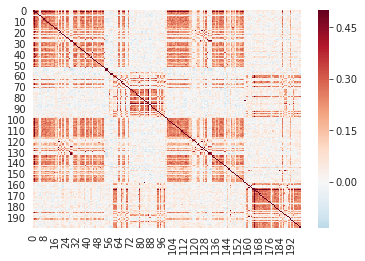

In [91]:
sns.heatmap(org_whobpyt_fc, cmap='RdBu_r',center=0,vmax=0.5)

In [92]:
%%time
whobpyt_count = 0
whobpyt_avg_dmn_ntx = np.zeros(32492,)
for i in range(73,100):
    whobpyt_count +=1
    whobpyt_lh_emp_ntwx_roi = lh_new_surf_for_neg_fc(org_whobpyt_fc, i)
    whobpyt_avg_dmn_ntx += whobpyt_lh_emp_ntwx_roi
    
whobpyt_avg_dmn_ntx = whobpyt_avg_dmn_ntx/whobpyt_count

CPU times: user 13.3 ms, sys: 1.03 ms, total: 14.4 ms
Wall time: 12.4 ms


In [93]:
emp_disp_lh = view_surf([pial_vtx,pial_tri], whobpyt_avg_dmn_ntx ,cmap='RdBu_r', vmax=0.3,vmin=-0.3, symmetric_cmap=True)#, threshold=0.1)
display(emp_disp_lh)


#### lesion whobpyt

In [97]:
lesion_whobpyt_fc = np.corrcoef(dmn_iso_data.output_sim.bold_test)

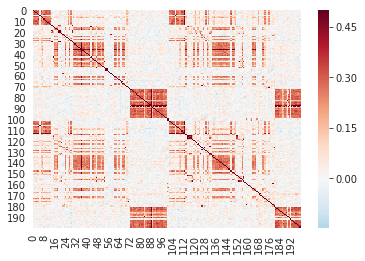

In [98]:
sns.heatmap(lesion_whobpyt_fc, cmap='RdBu_r',center=0,vmax=0.5)

In [99]:
%%time
lesion_whobpyt_count = 0
lesion_whobpyt_avg_dmn_ntx = np.zeros(32492,)
for i in range(73,100):
    lesion_whobpyt_count +=1
    lesion_whobpyt_lh_emp_ntwx_roi = lh_new_surf_for_neg_fc(lesion_whobpyt_fc, i)
    lesion_whobpyt_avg_dmn_ntx += lesion_whobpyt_lh_emp_ntwx_roi
    
lesion_whobpyt_avg_dmn_ntx = lesion_whobpyt_avg_dmn_ntx/lesion_whobpyt_count

CPU times: user 8.62 ms, sys: 1.13 ms, total: 9.75 ms
Wall time: 8 ms


In [100]:
emp_disp_lh = view_surf([pial_vtx,pial_tri], lesion_whobpyt_avg_dmn_ntx ,cmap='RdBu_r', vmax=0.3,vmin=-0.3, symmetric_cmap=True)#, threshold=0.1)
display(emp_disp_lh)


### Right hemisphere

#### empirical

In [101]:
%%time
rh_count = 0
rh_avg_dmn_ntx = np.zeros(32492,)
for i in range(181,200):
    rh_count +=1
    rh_emp_ntwx_roi = rh_new_surf_for_neg_fc(_var, i)
    rh_avg_dmn_ntx += rh_emp_ntwx_roi
    
rh_avg_dmn_ntx = rh_avg_dmn_ntx/rh_count

CPU times: user 8.98 ms, sys: 1.92 ms, total: 10.9 ms
Wall time: 8.49 ms


In [102]:
emp_disp_rh = view_surf([r_pial_vtx,r_pial_tri], rh_avg_dmn_ntx ,cmap='RdBu_r', vmax=0.5,vmin=-0.5, symmetric_cmap=True)#, threshold=0.1)
display(emp_disp_rh)


#### original whobpyt

In [103]:
%%time
rh_whobpyt_count = 0
rh_whobpyt_avg_dmn_ntx = np.zeros(32492,)
for i in range(181,200):
    rh_whobpyt_count +=1
    rh_whobpyt_lh_emp_ntwx_roi = rh_new_surf_for_neg_fc(org_whobpyt_fc, i)
    rh_whobpyt_avg_dmn_ntx += rh_whobpyt_lh_emp_ntwx_roi
    
rh_whobpyt_avg_dmn_ntx = rh_whobpyt_avg_dmn_ntx/rh_whobpyt_count

CPU times: user 10 ms, sys: 1.08 ms, total: 11.1 ms
Wall time: 9 ms


In [104]:
emp_disp_rh = view_surf([r_pial_vtx,r_pial_tri], rh_whobpyt_avg_dmn_ntx ,cmap='RdBu_r', vmax=0.3,vmin=-0.3, symmetric_cmap=True)#, threshold=0.1)
display(emp_disp_rh)


#### lesion whobpyt


In [105]:
%%time
rh_lesion_whobpyt_count = 0
rh_lesion_whobpyt_avg_dmn_ntx = np.zeros(32492,)
for i in range(181,200):
    rh_lesion_whobpyt_count +=1
    rh_lesion_whobpyt_lh_emp_ntwx_roi = rh_new_surf_for_neg_fc(lesion_whobpyt_fc, i)
    rh_lesion_whobpyt_avg_dmn_ntx += rh_lesion_whobpyt_lh_emp_ntwx_roi
    
rh_lesion_whobpyt_avg_dmn_ntx = rh_lesion_whobpyt_avg_dmn_ntx/rh_lesion_whobpyt_count

CPU times: user 7.53 ms, sys: 43 µs, total: 7.57 ms
Wall time: 6.49 ms


In [106]:
emp_disp_rh = view_surf([r_pial_vtx,r_pial_tri], rh_lesion_whobpyt_avg_dmn_ntx ,cmap='RdBu_r', vmax=0.3,vmin=-0.3, symmetric_cmap=True)#, threshold=0.1)
display(emp_disp_rh)


In [107]:
# Create a new matrix with the same shape as the original matrix
modified_matrix = original_sc.copy()

#### no-cross-hemipsheric connections

In [111]:
modified_matrix[181:200,73:100] = 0
modified_matrix[73:100,181:200] = 0

In [112]:
cross_dmn_sc = modified_matrix.copy()

In [113]:
cross_dmn_iso_data = g

In [114]:
cross_dmn_iso_data.model.sc = cross_dmn_sc.copy()

In [115]:
%%time
cross_dmn_iso_data.test(20)

0.49284947876810253 cos_sim:  0.9976706080098219
CPU times: user 5min 17s, sys: 8.48 s, total: 5min 25s
Wall time: 5min 26s


In [ ]:
original_matrix = original_sc.copy()
# print(original_matrix)
sns.heatmap(original_sc)

In [ ]:
sns.heatmap(org_whobpyt_fc, cmap='RdBu_r',center=0,vmax=0.5)

In [ ]:
modified_matrix[73:100,0:73] = 0
modified_matrix[73:100,100:181] = 0
modified_matrix[181:200,0:73] = 0
modified_matrix[181:200,100:181] = 0

modified_matrix[0:73,73:100] = 0
modified_matrix[100:181,73:100] = 0
modified_matrix[0:73,181:200] = 0
modified_matrix[100:181,181:200] = 0

sns.heatmap(modified_matrix)

In [ ]:
modified_matrix = modified_matrix/np.linalg.norm(modified_matrix)

In [ ]:
sns.heatmap(modified_matrix)

In [ ]:
sns.heatmap(lesion_whobpyt_fc, cmap='RdBu_r',center=0,vmax=0.5)

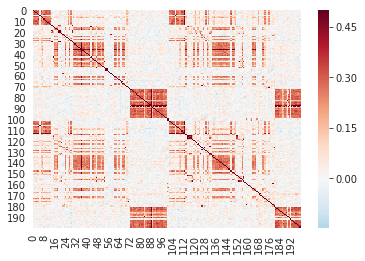

In [121]:
sns.heatmap(lesion_whobpyt_fc, cmap='RdBu_r',center=0,vmax=0.5)

In [ ]:
sns.heatmap(modified_matrix)

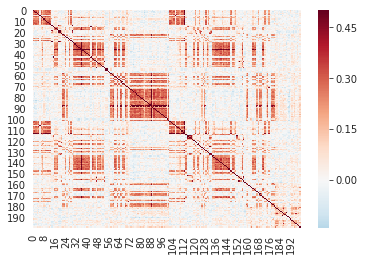

In [116]:
sns.heatmap(np.corrcoef(cross_dmn_iso_data.output_sim.bold_test), cmap='RdBu_r',center=0,vmax=0.5)

In [117]:
cross_hemi_cut_fc = np.corrcoef(cross_dmn_iso_data.output_sim.bold_test)

In [118]:
%%time
cross_hemi_rh_lesion_whobpyt_count = 0
cross_hemi_rh_lesion_whobpyt_avg_dmn_ntx = np.zeros(32492,)
for i in range(181,200):
    cross_hemi_rh_lesion_whobpyt_count +=1
    cross_hemi_rh_lesion_whobpyt_lh_emp_ntwx_roi = rh_new_surf_for_neg_fc(cross_hemi_cut_fc, i)
    cross_hemi_rh_lesion_whobpyt_avg_dmn_ntx += cross_hemi_rh_lesion_whobpyt_lh_emp_ntwx_roi
    
cross_hemi_rh_lesion_whobpyt_avg_dmn_ntx = cross_hemi_rh_lesion_whobpyt_avg_dmn_ntx/cross_hemi_rh_lesion_whobpyt_count

CPU times: user 7.35 ms, sys: 76 µs, total: 7.43 ms
Wall time: 5.91 ms


In [119]:
emp_disp_rh = view_surf([r_pial_vtx,r_pial_tri], cross_hemi_rh_lesion_whobpyt_avg_dmn_ntx ,cmap='RdBu_r', vmax=0.3,vmin=-0.3, symmetric_cmap=True)#, threshold=0.1)
display(emp_disp_rh)


In [120]:
emp_disp_rh = view_surf([r_pial_vtx,r_pial_tri], rh_lesion_whobpyt_avg_dmn_ntx ,cmap='RdBu_r', vmax=0.3,vmin=-0.3, symmetric_cmap=True)#, threshold=0.1)
display(emp_disp_rh)


In [122]:
emp_disp_rh = view_surf([r_pial_vtx,r_pial_tri], rh_whobpyt_avg_dmn_ntx ,cmap='RdBu_r', vmax=0.3,vmin=-0.3, symmetric_cmap=True)#, threshold=0.1)
display(emp_disp_rh)


#### cross hemisphere cut

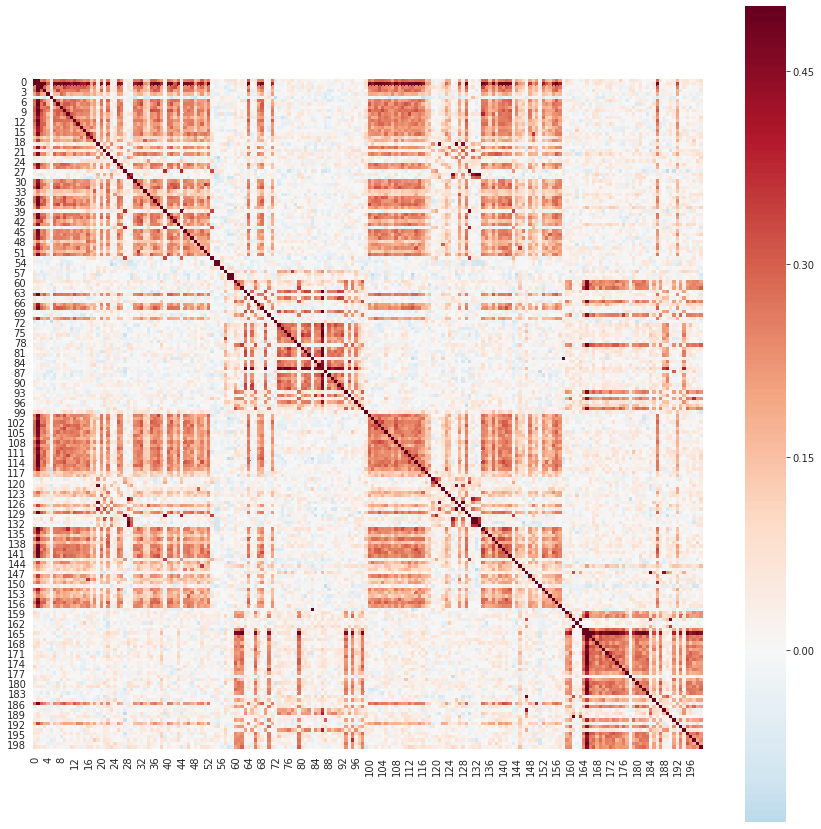

In [123]:
fig,ax = plt.subplots(figsize=(15,15))
sns.heatmap(org_whobpyt_fc, cmap='RdBu_r',center=0,vmax=0.5)
ax.set_aspect('equal')

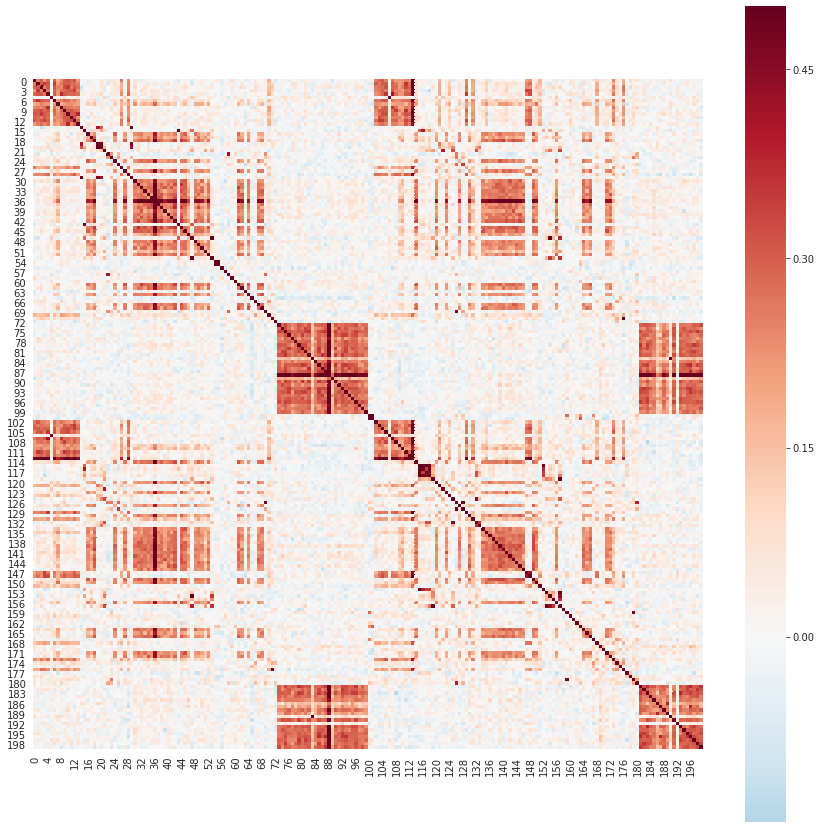

In [124]:
fig,ax = plt.subplots(figsize=(15,15))
sns.heatmap(lesion_whobpyt_fc, cmap='RdBu_r',center=0,vmax=0.5)
ax.set_aspect('equal')

In [125]:
dmn_only_whobpyt_fc = org_whobpyt_fc[73:100,73:100]

dmn_only_lesion_whobpyt_fc = lesion_whobpyt_fc[73:100,73:100]

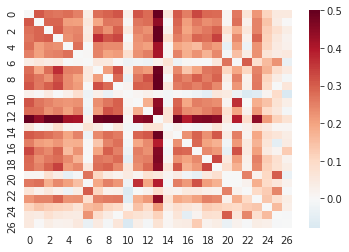

In [126]:
sns.heatmap(dmn_only_whobpyt_fc-np.diag(np.diag(dmn_only_whobpyt_fc)), cmap='RdBu_r',center=0,vmax=0.5)

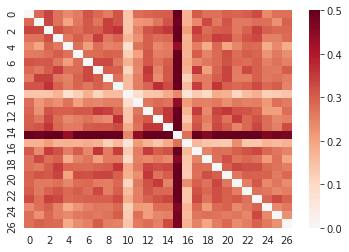

In [127]:
sns.heatmap(dmn_only_lesion_whobpyt_fc-np.diag(np.diag(dmn_only_lesion_whobpyt_fc)), cmap='RdBu_r',center=0,vmax=0.5)

In [131]:
u,d,v = np.linalg.svd(dmn_only_whobpyt_fc)

In [132]:
u.shape

(27, 27)

In [133]:
d.shape

(27,)

In [134]:
u[:,0]

array([-0.24263236, -0.21989263, -0.22412868, -0.2427147 , -0.19339833,
       -0.19475464, -0.02796508, -0.21899409, -0.22895746, -0.23599743,
       -0.00645503, -0.21551509, -0.2159801 , -0.36081147, -0.02904221,
       -0.22674403, -0.1841317 , -0.21706572, -0.21730795, -0.22427907,
       -0.03449606, -0.1966567 , -0.04278529, -0.20191227, -0.10343419,
       -0.05595965, -0.03205672])

In [135]:
u1,d1,v1 = np.linalg.svd(dmn_only_lesion_whobpyt_fc)

In [137]:
u1.shape

(27, 27)

In [138]:
u1[:,0]

array([-0.19369075, -0.1863647 , -0.20880539, -0.19702088, -0.16723487,
       -0.18622053, -0.19151983, -0.19730807, -0.19200704, -0.20195006,
       -0.09767296, -0.17038532, -0.20146842, -0.19309624, -0.20440391,
       -0.31858482, -0.11361002, -0.19755311, -0.17412771, -0.20171735,
       -0.19983388, -0.18759911, -0.19220743, -0.20402063, -0.17412707,
       -0.17705189, -0.17719225])

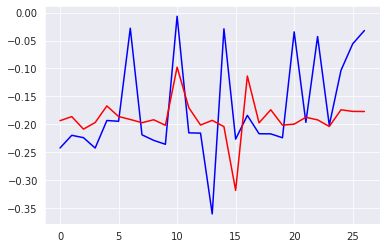

In [145]:
plt.plot(u[:,0],c='b')
plt.plot(u1[:,0],c='r')
plt.show()

In [128]:
rh_dmn_only_whobpyt_fc = org_whobpyt_fc[181:200,181:200]

rh_dmn_only_lesion_whobpyt_fc = lesion_whobpyt_fc[181:200,181:200]

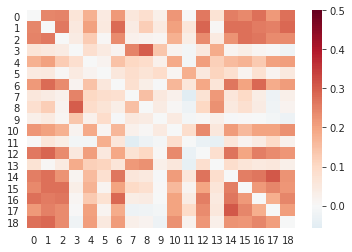

In [129]:
sns.heatmap(rh_dmn_only_whobpyt_fc-np.diag(np.diag(rh_dmn_only_whobpyt_fc)), cmap='RdBu_r',center=0,vmax=0.5)

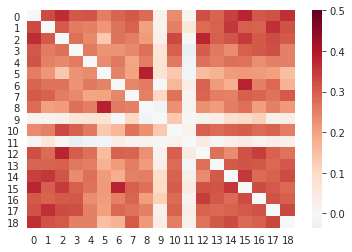

In [130]:
sns.heatmap(rh_dmn_only_lesion_whobpyt_fc-np.diag(np.diag(rh_dmn_only_lesion_whobpyt_fc)), cmap='RdBu_r',center=0,vmax=0.5)

In [ ]:
# check the weights ... 

In [ ]:
# extract metrics that looks at how the dmn is connected
# taking one dmn parcel from the simulated fc and average across parcels 

In [ ]:
# Next step: re-introduce sc for each of the other networks 